In [1]:
from pixell import enmap, utils, fft, enplot
from orphics import maps as omaps
import numpy as np
import matplotlib.pyplot as plt
import scipy

%matplotlib inline
%load_ext autoreload
%autoreload 2

In [12]:
shape, wcs = enmap.fullsky_geometry(res=0.5*utils.arcmin)
template = enmap.zeros(shape, wcs)
#sshape, swcs = omaps.rect_geometry(width_deg=10, height_deg=10)
#sshape_target, swcs_target = omaps.rect_geometry(width_deg=10, height_deg=10, yoffset_degree=85)
print(shape)

ymid = 10800
xmid = int(43200/2)
dy   = 2*60*10
dx   = dy*180
temp = template[ymid-dy: ymid+dy,:]
sshape, swcs = temp.shape, temp.wcs

temp = template[:2*dy,:]
sshape_target, swcs_target = temp.shape, temp.wcs

print(sshape, swcs, sshape_target, swcs_target)


(21601, 43200)
(2400, 43200) car:{cdelt:[-0.008333,0.008333],crval:[0.004167,0],crpix:[2.16e+04,1201]} (2400, 43200) car:{cdelt:[-0.008333,0.008333],crval:[0.004167,0],crpix:[2.16e+04,1.08e+04]}


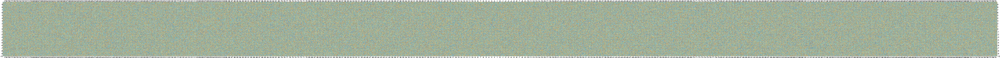

In [13]:
## generate a test stamp
l   = np.arange(10000+1)
cov = np.ones(len(l))
cov[:2] = 0.
stamp = enmap.rand_map(sshape, swcs, cov)
enplot.pshow(stamp, downgrade=4)

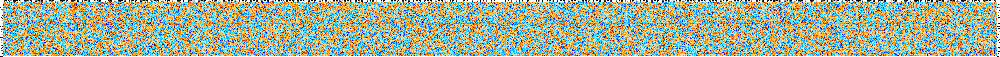

In [14]:
## test rotating
MR = omaps.MapRotator(sshape, swcs, sshape_target, swcs_target)
rotated_stamp = enmap.enmap(MR.rotate(stamp), swcs_target)
enplot.pshow(enmap.rand_map(sshape_target, swcs_target, cov), downgrade=4)

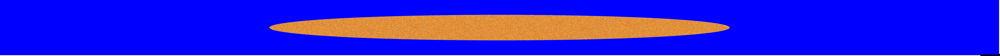

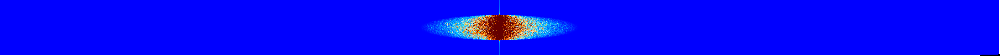

In [15]:
## Look at PS
FC = omaps.FourierCalc(sshape, swcs)
FC_rotated = omaps.FourierCalc(sshape_target, swcs_target)

ps2d_stamp, _, _= FC.power2d(stamp)
ps2d_stamp_x = np.sqrt(np.mean(ps2d_stamp, axis=0))
ps2d_stamp_y = np.sqrt(np.mean(ps2d_stamp, axis=1))
laxes = enmap.laxes(sshape, swcs)
enplot.pshow(np.fft.fftshift(ps2d_stamp), downgrade=4)


ps2d_stamp_rotated, _, _= FC.power2d(rotated_stamp)
ps2d_stamp_rotated_x = np.sqrt(np.mean(ps2d_stamp_rotated, axis=0))
ps2d_stamp_rotated_y = np.sqrt(np.mean(ps2d_stamp_rotated, axis=1))
laxes_rotated = enmap.laxes(sshape_target, swcs_target)
ps2d_stamp_rotmichael jackson bad gleeated_x_intep = scipy.interpolate.interp1d(np.fft.fftshift(laxes_rotated[1]), 
                                                        np.fft.fftshift(ps2d_stamp_rotated_x),  
                                                        bounds_error=False, fill_value=(np.inf, np.inf)
                                                       ,assume_sorted=False)
enplot.pshow(np.fft.fftshift(ps2d_stamp_rotated), downgrade=4)



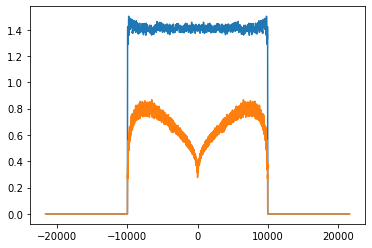

In [16]:

plt.plot(np.fft.fftshift(laxes[0]), np.fft.fftshift(ps2d_stamp_y/ps2d_stamp_rotated_y))
plt.plot(np.fft.fftshift(laxes[1]), np.fft.fftshift(ps2d_stamp_x/ps2d_stamp_rotated_x_intep(laxes[1])))
plt.show()



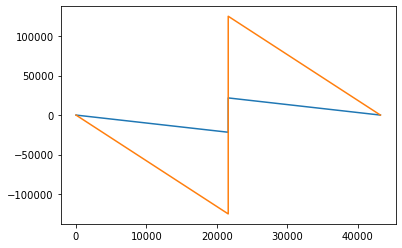

In [17]:
plt.plot(laxes[1])
plt.plot(laxes_rotated[1])